In [25]:
import torch
torch.cuda.is_available()

True

In [33]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import random

In [34]:
df1 = pd.read_csv('data/1step.csv', index_col='time')
df2 = pd.read_csv('data/2step.csv', index_col='time')
df1_ratio = pd.read_csv('data/1step_percent.csv', index_col='time')
df2_ratio = pd.read_csv('data/2step_percent.csv', index_col='time')

# int columns
df1.columns = [int(i) for i in df1.columns]
df1.columns = [int(i) for i in df2.columns]
df1_ratio.columns = [int(i) for i in df1_ratio.columns]
df2_ratio.columns = [int(i) for i in df2_ratio.columns]

In [35]:
df2_ratio.iloc[3264:3668]

,2,3,4,5,6,7,8,9,10,11,...,306,307,308,309,310,311,312,313,314,315
time,,,,,,,,,,,,,,,,,,,,,
652.8,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
653.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
653.2,0.0,0.000111,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000371,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
653.4,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000990,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
653.6,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
732.6,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000327,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
732.8,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
733.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000113,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [36]:
df1_pre = df1.iloc[3000:3316]
df1_post = df1.iloc[4577:4793]
df2_pre = df2.iloc[3264:3668]
df2_post = df2.iloc[6895:7299]

In [37]:
df1_pre_ratio = df1_ratio.iloc[3000:3316]
df1_post_ratio = df1_ratio.iloc[4577:4793]
df2_pre_ratio = df2_ratio.iloc[3264:3668]
df2_post_ratio = df2_ratio.iloc[6895:7299]

In [38]:
# random color generator
random.seed(315)
colors = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(20)]

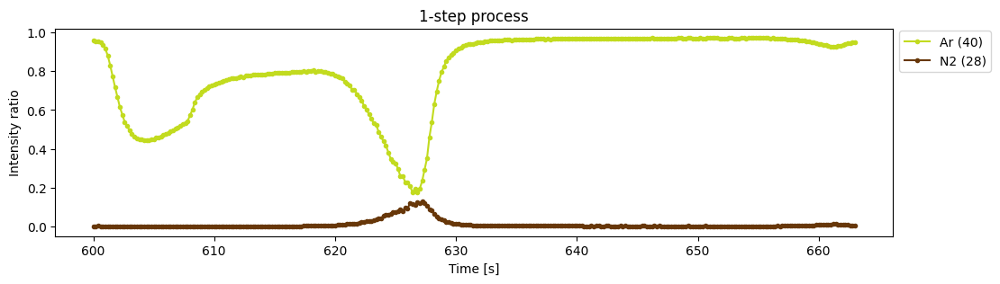

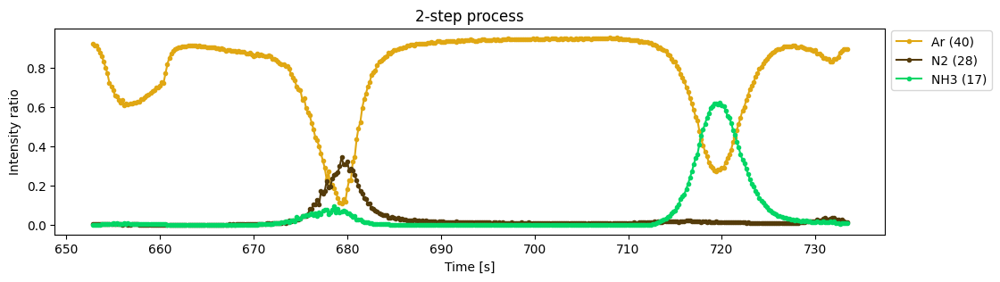

In [40]:
# intensity change of H2O (18)
plt.figure(figsize=(12,3))
plt.plot(df1_pre_ratio.loc[:,40],'.-', color=colors[3])
plt.plot(df1_pre_ratio.loc[:,17],'.-', color=colors[5])
plt.xlabel('Time [s]')
# plt.xlim(575,900)
plt.ylabel('Intensity ratio')
plt.title('1-step process')
plt.legend(['Ar (40)','N2 (28)'], bbox_to_anchor=(1,1.02), loc='upper left')
plt.show()

plt.figure(figsize=(12,3))
plt.plot(df2_pre_ratio.loc[:,40],'.-', color=colors[4])
plt.plot(df2_pre_ratio.loc[:,17],'.-', color=colors[6])
plt.plot(df2_pre_ratio.loc[:,28],'.-', color=colors[9])
plt.xlabel('Time [s]')
# plt.xlim(640,1100)
plt.ylabel('Intensity ratio')
plt.legend(['Ar (40)','N2 (28)','NH3 (17)'], bbox_to_anchor=(1,1.02), loc='upper left')
plt.title('2-step process')
plt.show()

In [48]:
# two interactive plots
# make them interactive
x = df1_pre_ratio.loc[:,40].index
y1 = df1_pre_ratio.loc[:,40]
y2 = df1_pre_ratio.loc[:,17]
clicked = []

fig = go.FigureWidget([go.Scatter(x=x, y=y1, mode='lines+markers', name='Ar(40)'), 
                       go.Scatter(x=x, y=y2, mode='lines+markers', name='NH3(17)')])
fig.update_layout(plot_bgcolor="white", yaxis_range=[0,1], xaxis_title='Time [s]', 
                  yaxis_title='Intensity ratio', title='1-step process')
fig.update_xaxes(mirror=True, gridcolor='lightgrey', showgrid=True, linecolor='lightgray', showline=True)
fig.update_yaxes(mirror=True, gridcolor='lightgrey', showgrid=True, linecolor='lightgray', showline=True)

#1
scatter1 = fig.data[0]
cust_color1 = colors[3]
scatter1.line.color = cust_color1
scatter1.marker.color = [cust_color1] * len(x)
scatter1.marker.size = [4] * len(x)
scatter1.marker.line.color = [cust_color1] * len(x)
scatter1.marker.line.width = [1] * len(x)
#2
scatter2 = fig.data[1]
cust_color2 = colors[5]
scatter2.line.color = cust_color2
scatter2.marker.color = [cust_color2] * len(x)
scatter2.marker.size = [4] * len(x)
scatter2.marker.line.color = [cust_color2] * len(x)
scatter2.marker.line.width = [1] * len(x)
fig.layout.hovermode = 'closest'


# create our callback functions
def update_point(trace, points, selector):
    #1
    c1 = list(scatter1.marker.color)
    s1 = list(scatter1.marker.size)
    for i in points.point_inds:
        c1[i] = colors[2]
        s1[i] = 10
        with fig.batch_update():
            scatter1.marker.color = c1
            scatter1.marker.size = s1
    #2
    c2 = list(scatter2.marker.color)
    s2 = list(scatter2.marker.size)
    for j in points.point_inds:
        c2[j] = colors[3]
        s2[j] = 10
        with fig.batch_update():
            scatter2.marker.color = c2
            scatter2.marker.size = s2
            
def store_value(trace, points, selector):
    global clicked
    clicked.append([points.__dict__['_xs'][0], points.__dict__['_ys'][0]])
    # df_peak.loc[len(df_peak)] = [points.__dict__['_xs'][0], points.__dict__['_ys'][1]]
    
def display_value(trace, points, selector):
    for point in points.point_inds:
        print(point)
        x_value = trace.x[point]
        y_value = trace.y[point]
        fig.add_annotation(x=x_value, y=y_value,
            text=f"<b>{np.round(x_value,3)}</b>", ax=0, ay=-25, font=dict(size=10))       
def wrapper(trace, points, selector):
    update_point(trace, points, selector)
    store_value(trace, points, selector)
    display_value(trace, points, selector)
    
# scatter1.on_click(wrapper)
scatter1.on_click(wrapper)
# scatter.on_click(store_value)

fig.show()

FigureWidget({
    'data': [{'line': {'color': '#C2DB1F'},
              'marker': {'color': [#C2DB1F, #C2DB1F, #C2DB1F, ..., #C2DB1F,
                                   #C2DB1F, #C2DB1F],
                         'line': {'color': [#C2DB1F, #C2DB1F, #C2DB1F, ...,
                                            #C2DB1F, #C2DB1F, #C2DB1F],
                                  'width': [1, 1, 1, ..., 1, 1, 1]},
                         'size': [4, 4, 4, ..., 4, 4, 4]},
              'mode': 'lines+markers',
              'name': 'Ar(40)',
              'type': 'scatter',
              'uid': '702ae26b-b0de-4f04-b262-2ed9821a9385',
              'x': {'bdata': ('AAAAAADAgkCamZmZmcGCQDMzMzMzw4' ... 'zMzLSEQGZmZmZmtoRAAAAAAAC4hEA='),
                    'dtype': 'f8'},
              'y': {'bdata': ('fUxgBHav7j/Uo8BOOJDuPxGa7H5tgO' ... '5tjz/uPz6WCavxXe4/gKQ2tVxd7j8='),
                    'dtype': 'f8'}},
             {'line': {'color': '#673709'},
              'marker': {'color': [#673709, #6737

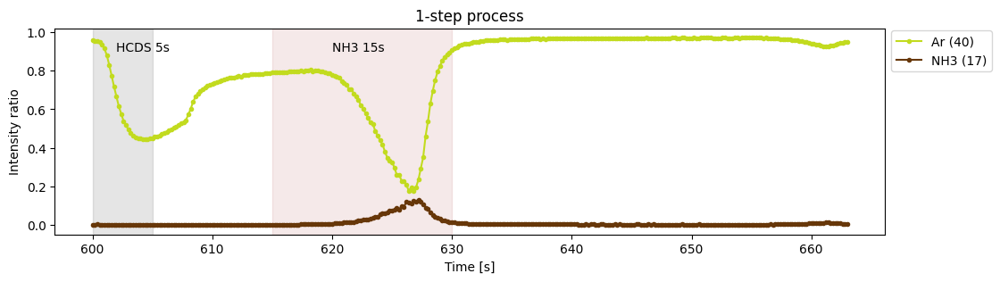

In [69]:
# intensity change of H2O (18)
plt.figure(figsize=(12,3))
plt.plot(df1_pre_ratio.loc[:,40],'.-', color=colors[3])
plt.plot(df1_pre_ratio.loc[:,17],'.-', color=colors[5])
plt.axvspan(600,605,ymin=0,ymax=1,color='black',alpha=0.1)
plt.text(602, 0.9, 'HCDS 5s')
plt.axvspan(615,630,ymin=0,ymax=1,color='brown',alpha=0.1)
plt.text(620, 0.9, 'NH3 15s')
plt.xlabel('Time [s]')
plt.ylabel('Intensity ratio')
plt.title('1-step process')
plt.legend(['Ar (40)','NH3 (17)'], bbox_to_anchor=(1,1.02), loc='upper left')
plt.show()

In [271]:
# Example DataFrame
df = df1_pre_ratio
x = df.columns
index = df.index

# Create an empty figure
fig = go.Figure()

# Add frames for animation
frames = [
    go.Frame(
        data=[
            go.Bar(
                x=x, 
                y=df.loc[i],
                marker_color=(
                    colors[0] if i > 627 else  # Ar
                    colors[1] if i > 615 else  # NH3
                    colors[0] if i > 605 else
                    colors[2]  # HCDS
                ),
            ),
            go.Bar(
                x=x, 
                y=df.loc[i],
                marker_color=(
                    colors[0] if i > 627 else  # Ar
                    colors[1] if i > 615 else  # NH3
                    colors[0] if i > 605 else
                    colors[2]  # HCDS
                ),
            ),
        ],  # Use go.Bar for bar plot
                layout=go.Layout(
            annotations=[
                {
                    "text": (
                        'Ar' if i > 627 else
                        'NH3' if i > 615 else
                        'Ar' if i > 605 else
                        'HCDS' # Annotation text changes based on the condition
                    ),
                    "xref": "paper",
                    "yref": "paper",
                    "x": 0.5,
                    "y": 1.1,  # Position above the plot, below the title
                    "showarrow": False,
                    "font": {"size": 14},
                }
            ]
        ),
        name=str(i)
    )
    for i in index
]


# Initialize with the first frame (index 0.0)
fig.add_trace(go.Bar(x=x, y=df.loc[index[0]], name="Initial"))

# Set up the layout with animation settings and control
fig.update(frames=frames)
fig.update_layout(
    updatemenus=[
        {
            "buttons": [
                {
                    "args": [None, {"frame": {"duration": 500, "redraw": True}, "fromcurrent": True}],
                    "label": "Play",
                    "method": "animate"
                },
                {
                    "args": [[None], {"mode": "immediate", "frame": {"duration": 0, "redraw": False}}],
                    "label": "Pause",
                    "method": "animate"
                }
            ],
            "direction": "left",
            "pad": {"r": 10, "t": 87},
            "showactive": False,
            "type": "buttons",
            "x": 0.1,
            "xanchor": "right",
            "y": 0,
            "yanchor": "top"
        }
    ],
    sliders=[
        {
            "steps": [
                {
                    "args": [[str(i)], {"frame": {"duration": 0, "redraw": True}, "mode": "immediate"}],
                    "label": str(i),
                    "method": "animate"
                }
                for i in index
            ],
            "active": 0,
            "x": 0.1,
            "len": 0.9,
            "xanchor": "left",
            "y": -0.1,
            "yanchor": "top"
        }
    ],
)

# Add labels and title
fig.update_layout(
    title="One cycle during the 1-step process",
    xaxis_title="Mass [m/z]",
    yaxis_title="Intensity ratio",
    plot_bgcolor='white',
    yaxis_range=[0, 0.1],
    xaxis=dict(
    showgrid=True,  # Enable gridlines for the x-axis
    gridcolor="lightgray",  # Set the gridline color
    gridwidth=0.5  # Set the gridline width
    ),
    yaxis=dict(
    showgrid=True,  # Enable gridlines for the y-axis
    gridcolor="lightgray",  # Set the gridline color
    gridwidth=0.5  # Set the gridline width
    )
)

# Show the figure
fig.show()


In [217]:
df1_pre_ratio.columns

Index([  2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
       ...
       306, 307, 308, 309, 310, 311, 312, 313, 314, 315],
      dtype='int64', length=314)

In [241]:
df1_pre_ratio

,2,3,4,5,6,7,8,9,10,11,...,306,307,308,309,310,311,312,313,314,315
time,,,,,,,,,,,,,,,,,,,,,
600.0,0.000030,0.000018,0.000000,0.000000,0.0,0.000000,0.000000,0.000078,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
600.2,0.000023,0.000000,0.000041,0.000000,0.0,0.000022,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000019
600.4,0.000021,0.000000,0.000000,0.000000,0.0,0.000000,0.000015,0.000027,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
600.6,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
600.8,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000014,0.000015,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662.2,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
662.4,0.000037,0.000033,0.000040,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
662.6,0.000043,0.000000,0.000000,0.000021,0.0,0.000000,0.000000,0.000062,0.000000,0.000018,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000


In [254]:
# create a df for comparison
df1_byproducts_ratio = df1_pre_ratio.loc[605].T.to_frame()
df1_byproducts_ratio = df1_byproducts_ratio.rename(columns={605.0:'Byproducts of HCDS'})
df1_byproducts_ratio['Byproducts of NH3'] = df1_pre_ratio.loc[626.8].T.to_frame()
df1_byproducts_ratio = df1_byproducts_ratio.reset_index()

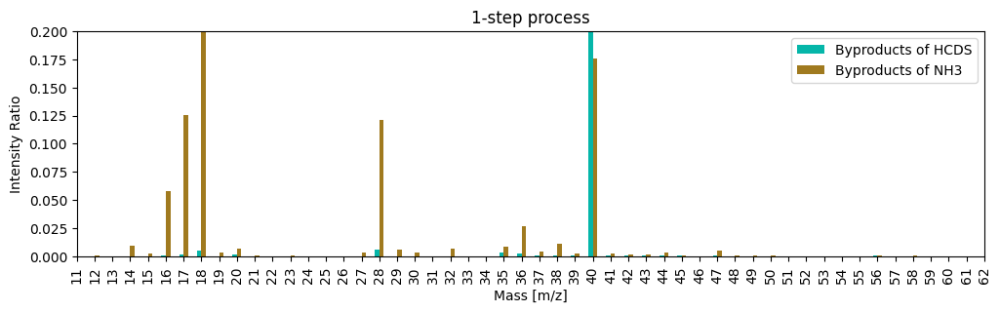

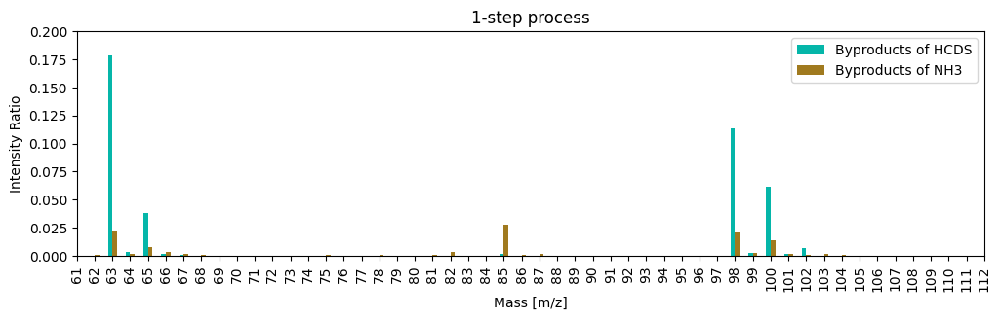

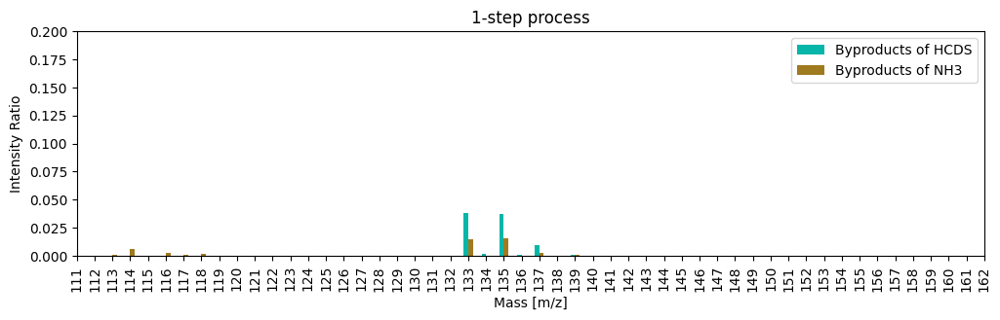

In [269]:
for i in range(3):
    axs = df1_byproducts_ratio.plot(figsize=(12,3), x='index', y=['Byproducts of HCDS', 'Byproducts of NH3'], kind='bar', color=[colors[10], colors[12]])
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Intensity Ratio')
    plt.title('1-step process')
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.2)
    plt.show()

    fig = axs.get_figure()
    fig.savefig(f'data/figure/1step_pre_byproducts_ratio{i}', bbox_inches='tight')

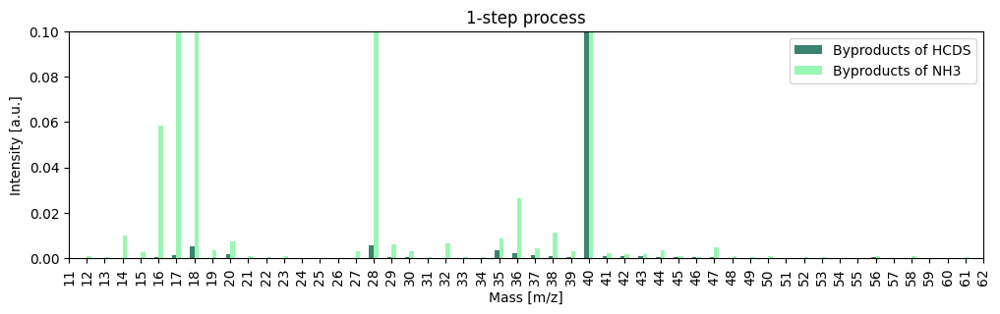

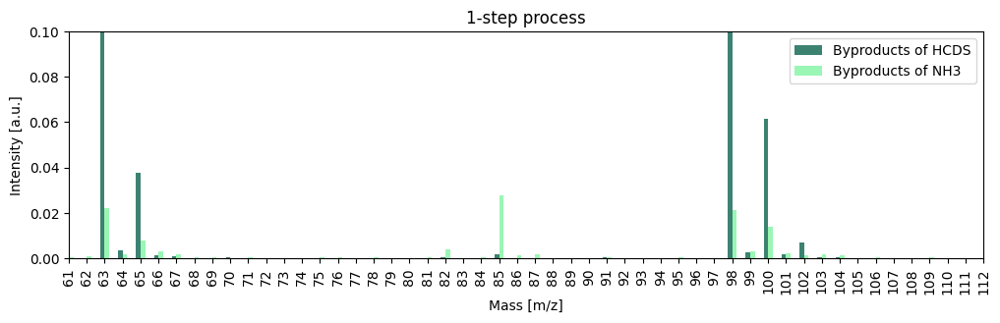

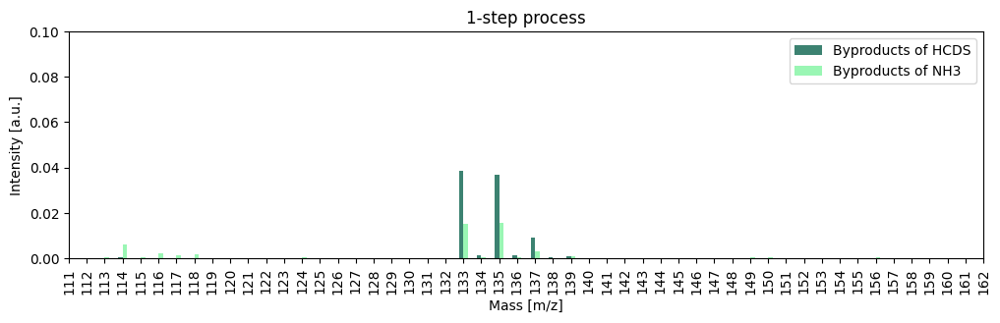

In [267]:
# create a df for comparison
df1_byproducts= df1_pre.loc[605].T.to_frame()
df1_byproducts = df1_byproducts.rename(columns={605.0:'Byproducts of HCDS'})
df1_byproducts['Byproducts of NH3'] = df1_pre.loc[626.8].T.to_frame()
df1_byproducts = df1_byproducts.reset_index()

for i in range(3):
    axs = df1_byproducts_ratio.plot(figsize=(12,3), x='index', y=['Byproducts of HCDS', 'Byproducts of NH3'], kind='bar', color=[colors[11], colors[14]])
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Intensity [a.u.]')
    plt.title('1-step process')
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.1)
    fig = axs.get_figure()
    fig.savefig(f'data/figure/1step_pre_byproducts{i}', bbox_inches='tight')
    plt.show()

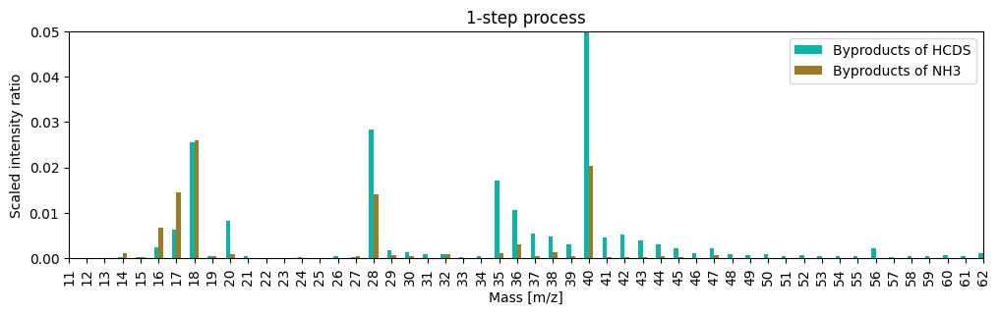

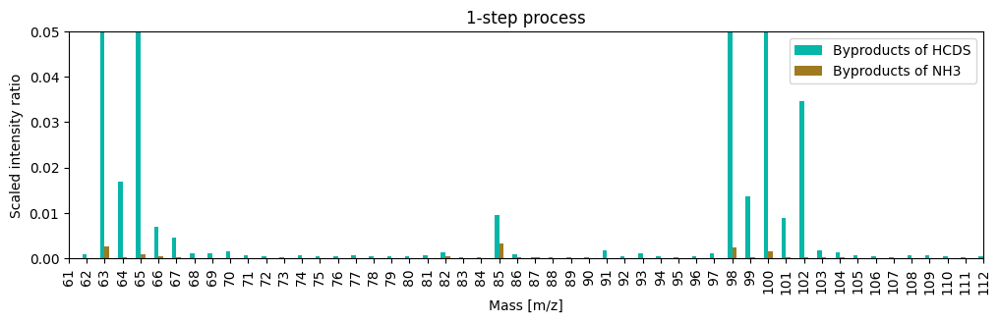

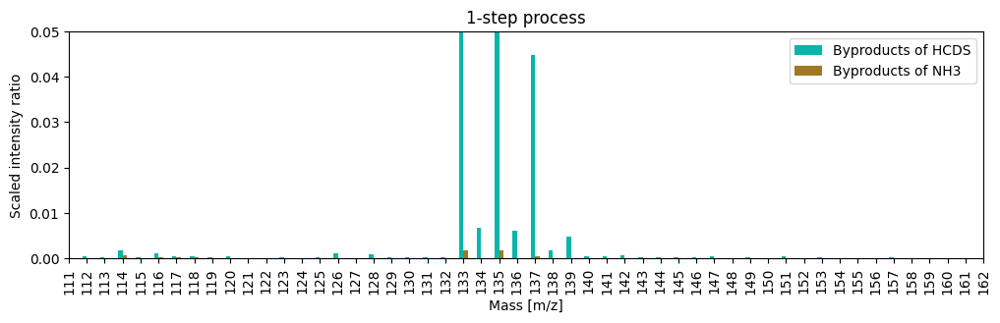

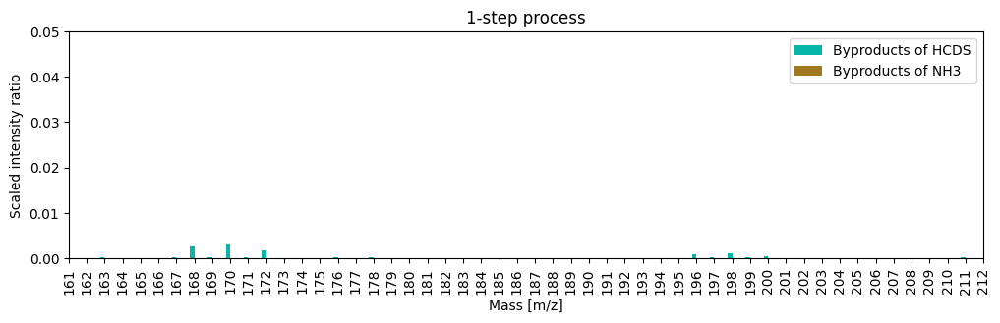

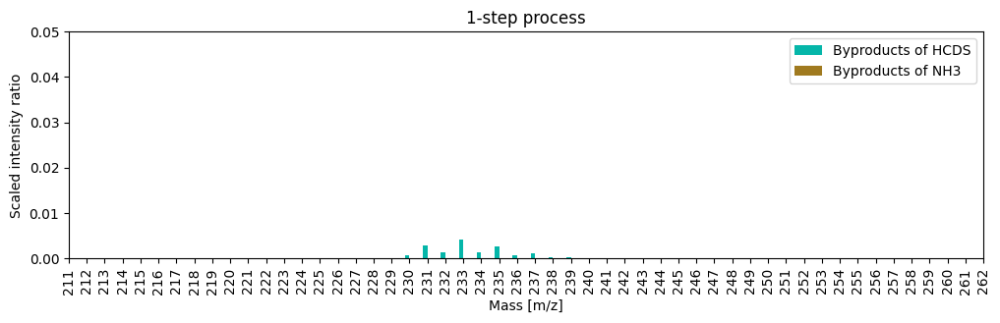

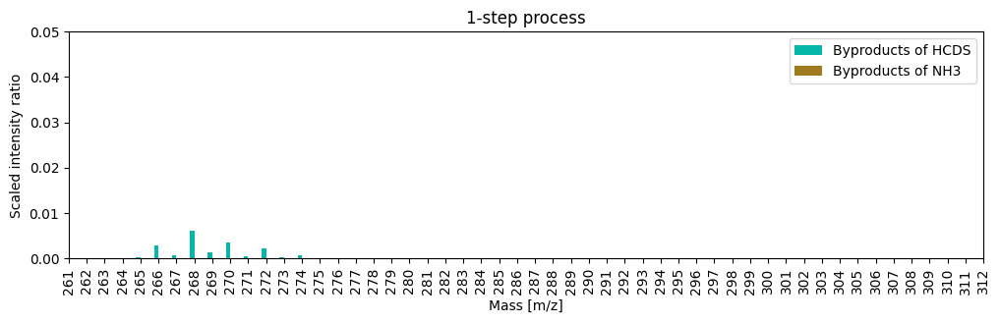

In [266]:
for i in range(6):
    df1_byproducts.plot(figsize=(12,3), x='index', y=['Byproducts of HCDS', 'Byproducts of NH3'], kind='bar', color=[colors[10], colors[12]])
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Scaled intensity ratio')
    plt.title('1-step process')
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.05)

    fig = axs.get_figure()
    fig.savefig(f'data/figure/1step_pre_byproducts_yscale{i}', bbox_inches='tight')
    plt.show()

In [272]:
# Example DataFrame
df = df1_pre / df1_pre.max().max()
x = df.columns
index = df.index

# Create an empty figure
fig = go.Figure()

# Add frames for animation
frames = [
    go.Frame(
        data=[
            go.Bar(
                x=x, 
                y=df.loc[i],
                marker_color=(
                    colors[0] if i > 627 else  # Ar
                    colors[1] if i > 615 else  # NH3
                    colors[0] if i > 605 else
                    colors[2]  # HCDS
                ),
            ),
            go.Bar(
                x=x, 
                y=df.loc[i],
                marker_color=(
                    colors[0] if i > 627 else  # Ar
                    colors[1] if i > 615 else  # NH3
                    colors[0] if i > 605 else
                    colors[2]  # HCDS
                ),
            ),
        ],  # Use go.Bar for bar plot
                layout=go.Layout(
            annotations=[
                {
                    "text": (
                        'Ar' if i > 627 else
                        'NH3' if i > 615 else
                        'Ar' if i > 605 else
                        'HCDS' # Annotation text changes based on the condition
                    ),
                    "xref": "paper",
                    "yref": "paper",
                    "x": 0.5,
                    "y": 1.1,  # Position above the plot, below the title
                    "showarrow": False,
                    "font": {"size": 14},
                }
            ]
        ),
        name=str(i)
    )
    for i in index
]


# Initialize with the first frame (index 0.0)
fig.add_trace(go.Bar(x=x, y=df.loc[index[0]], name="Initial"))

# Set up the layout with animation settings and control
fig.update(frames=frames)
fig.update_layout(
    updatemenus=[
        {
            "buttons": [
                {
                    "args": [None, {"frame": {"duration": 500, "redraw": True}, "fromcurrent": True}],
                    "label": "Play",
                    "method": "animate"
                },
                {
                    "args": [[None], {"mode": "immediate", "frame": {"duration": 0, "redraw": False}}],
                    "label": "Pause",
                    "method": "animate"
                }
            ],
            "direction": "left",
            "pad": {"r": 10, "t": 87},
            "showactive": False,
            "type": "buttons",
            "x": 0.1,
            "xanchor": "right",
            "y": 0,
            "yanchor": "top"
        }
    ],
    sliders=[
        {
            "steps": [
                {
                    "args": [[str(i)], {"frame": {"duration": 0, "redraw": True}, "mode": "immediate"}],
                    "label": str(i),
                    "method": "animate"
                }
                for i in index
            ],
            "active": 0,
            "x": 0.1,
            "len": 0.9,
            "xanchor": "left",
            "y": -0.1,
            "yanchor": "top"
        }
    ],
)

# Add labels and title
fig.update_layout(
    title="One cycle during the 1-step process",
    xaxis_title="Mass [m/z]",
    yaxis_title="Intensity [a.u.]",
    plot_bgcolor='white',
    yaxis_range=[0, 0.05],
    xaxis=dict(
    showgrid=True,  # Enable gridlines for the x-axis
    gridcolor="lightgray",  # Set the gridline color
    gridwidth=0.5  # Set the gridline width
    ),
    yaxis=dict(
    showgrid=True,  # Enable gridlines for the y-axis
    gridcolor="lightgray",  # Set the gridline color
    gridwidth=0.5  # Set the gridline width
    )
)

# Show the figure
fig.show()


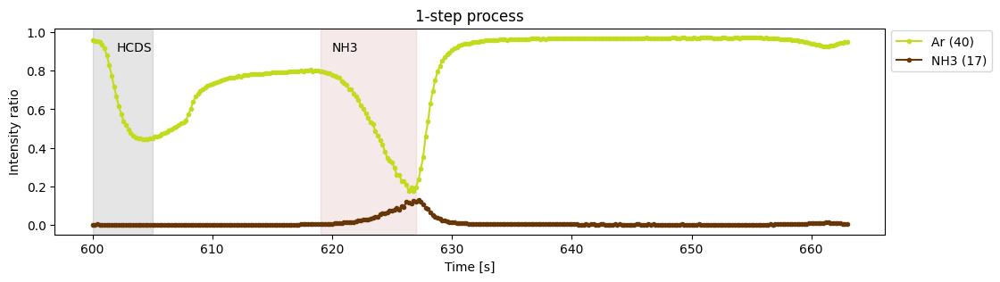

In [149]:
# intensity change of H2O (18)
plt.figure(figsize=(12,3))
plt.plot(df1_pre_ratio.loc[:,40],'.-', color=colors[3])
plt.plot(df1_pre_ratio.loc[:,17],'.-', color=colors[5])
plt.axvspan(600,605,ymin=0,ymax=1,color='black',alpha=0.1)
plt.text(602, 0.9, 'HCDS')
plt.axvspan(619,627,ymin=0,ymax=1,color='brown',alpha=0.1)
plt.text(620, 0.9, 'NH3')
plt.xlabel('Time [s]')
plt.ylabel('Intensity ratio')
plt.title('1-step process')
plt.legend(['Ar (40)','NH3 (17)'], bbox_to_anchor=(1,1.02), loc='upper left')
plt.show()

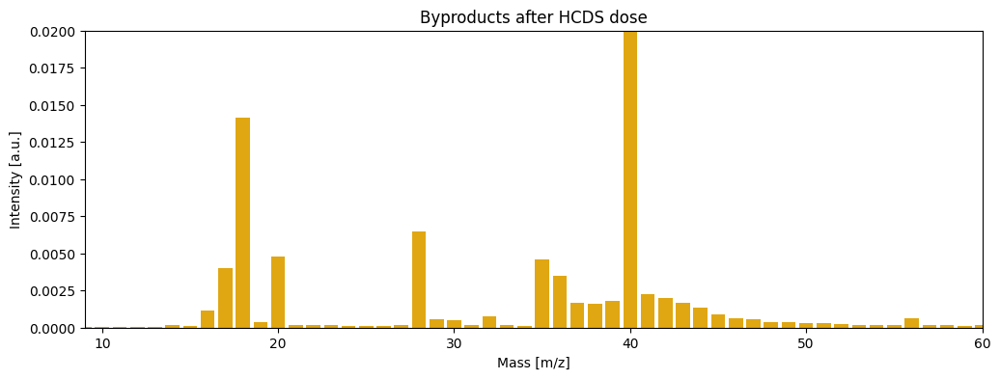

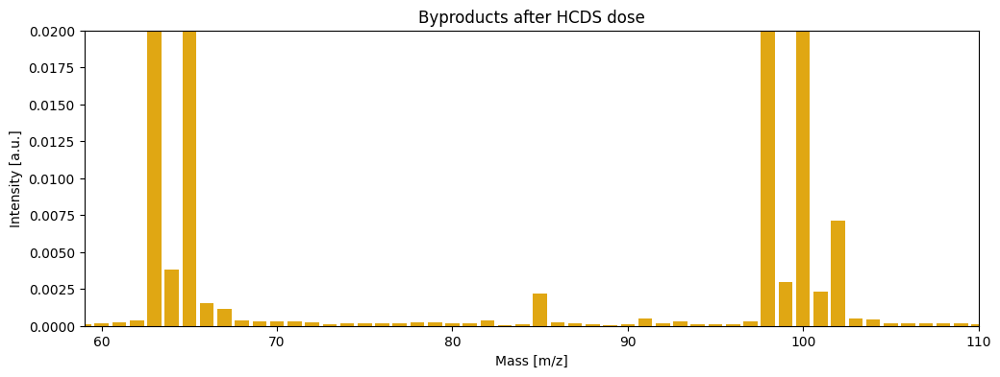

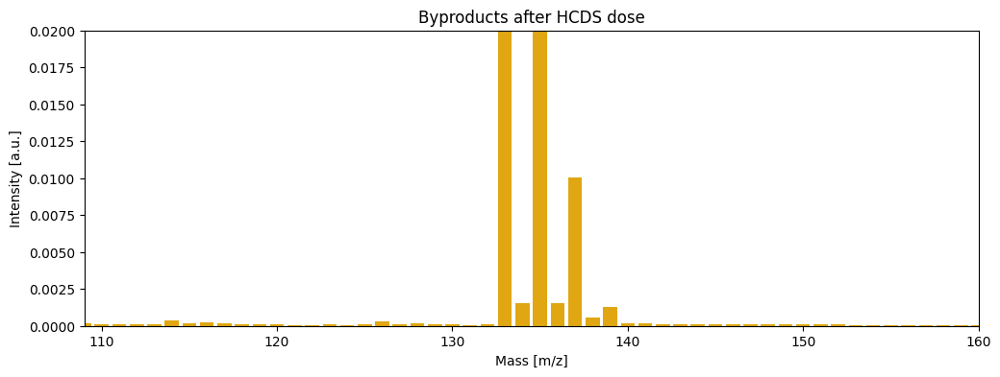

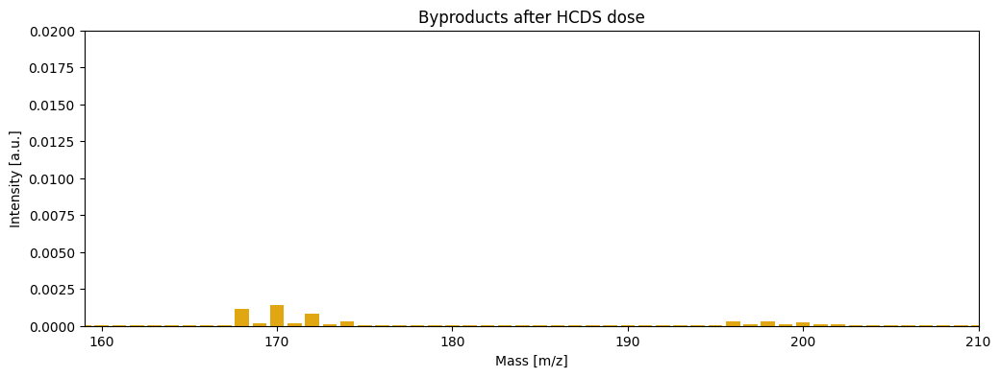

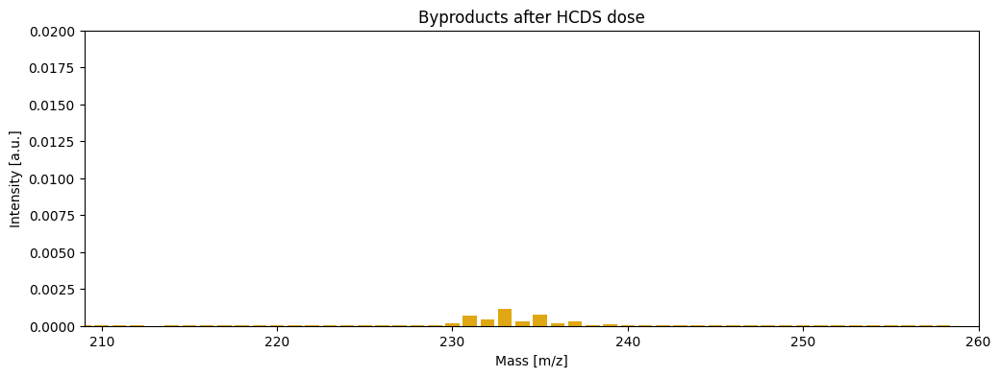

...

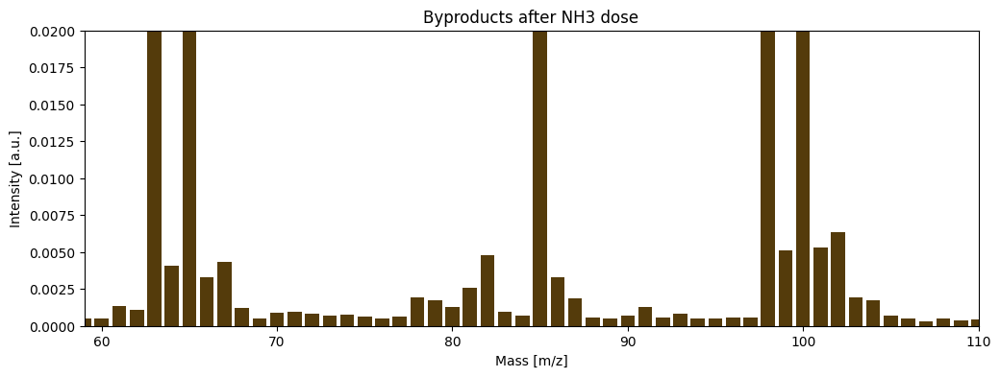

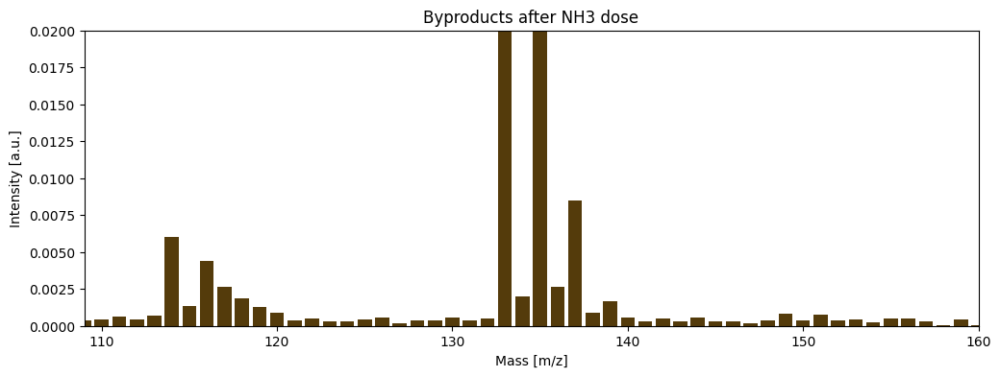

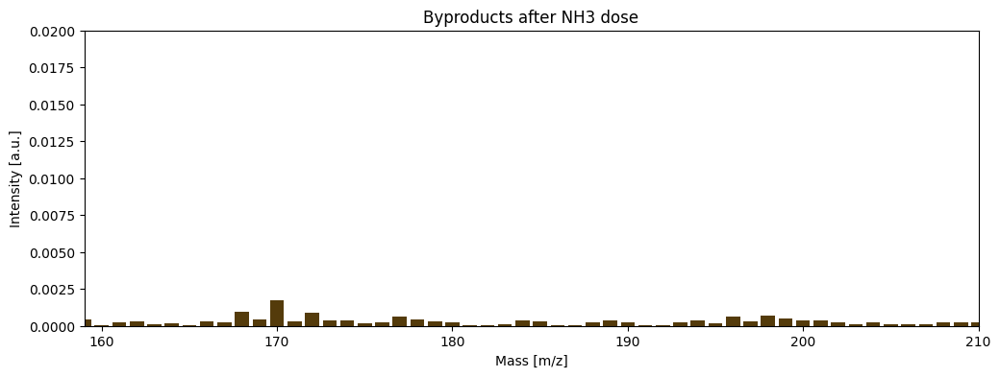

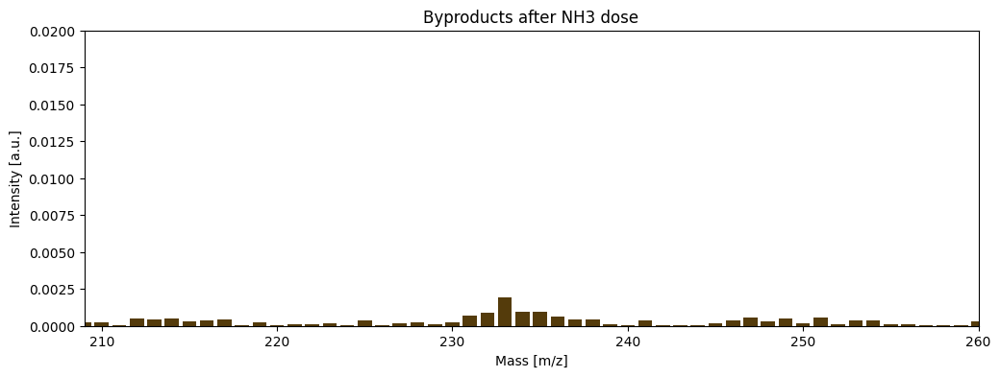

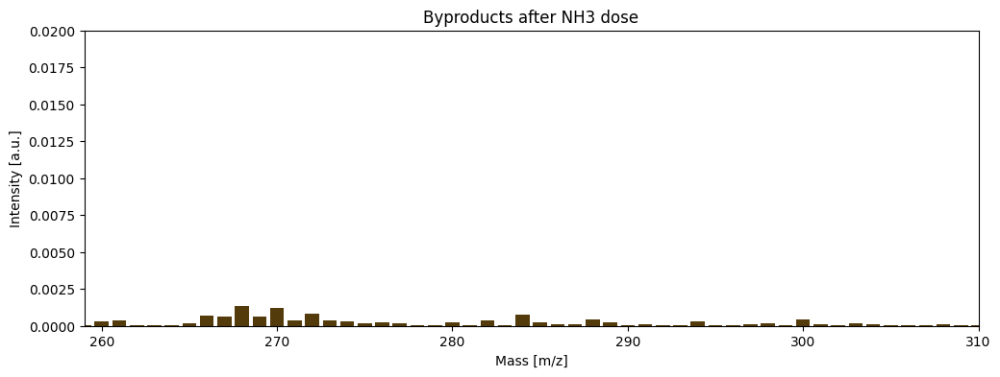

In [176]:
# split df1_pre into two parts and get maximum values
df1_pre_hcds = df1_pre_ratio.loc[600:605]
df1_pre_nh3 = df1_pre_ratio.loc[606:]

for i in range(6):
    plt.figure(figsize=(12,4))
    plt.bar(df1_pre_hcds.agg('max').index, df1_pre_hcds.agg('max').values, color=colors[4])
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.02)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Intensity [a.u.]')
    plt.title('Byproducts after HCDS dose')
    plt.show()

for i in range(6):
    plt.figure(figsize=(12,4))
    plt.bar(df1_pre_nh3.agg('max').index, df1_pre_nh3.agg('max').values, color=colors[6])
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.02)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Intensity [a.u.]')
    plt.title('Byproducts after NH3 dose')
    plt.show()

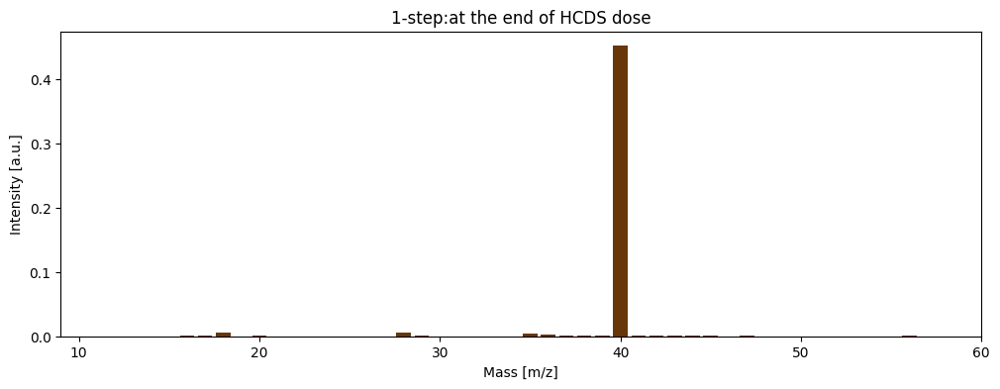

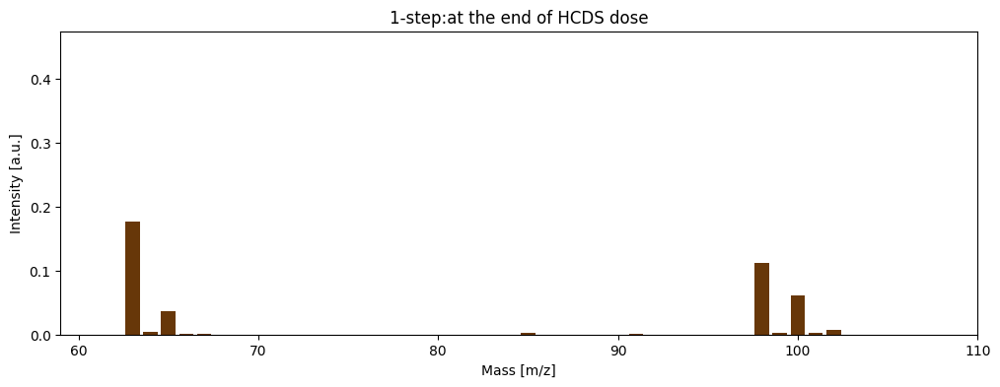

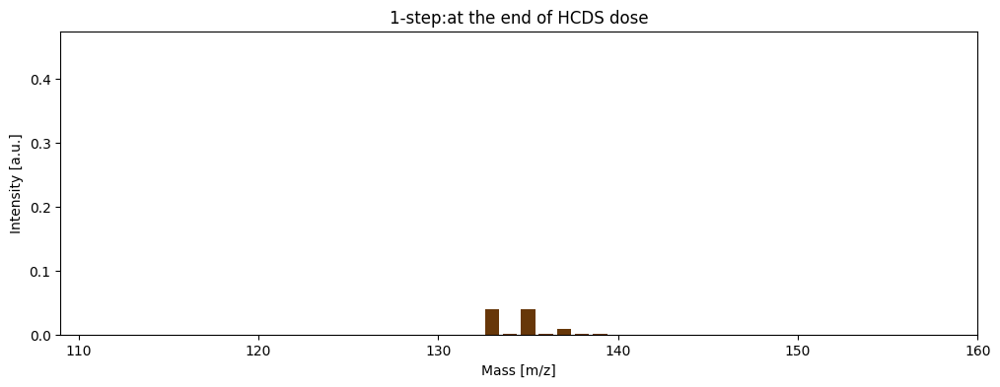

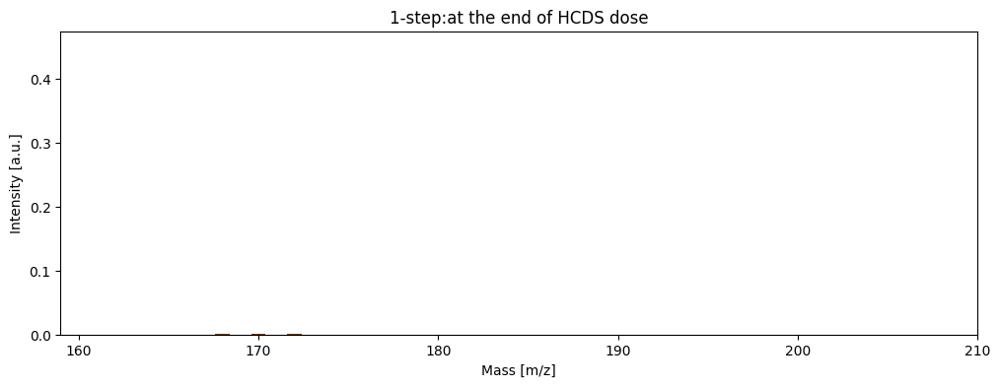

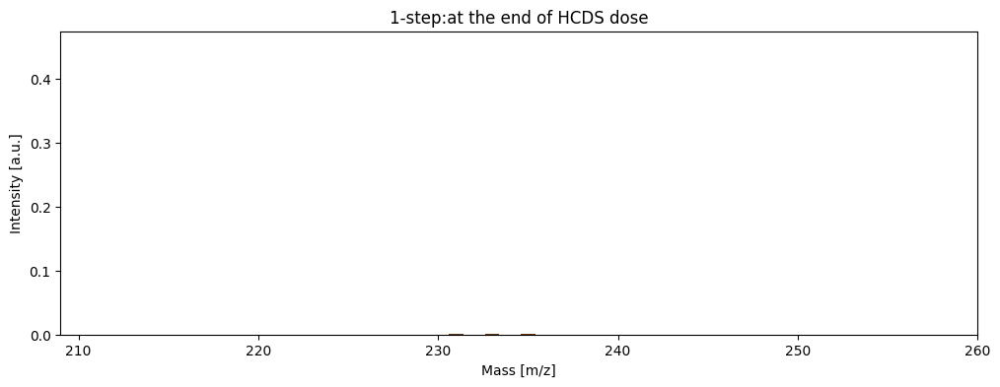

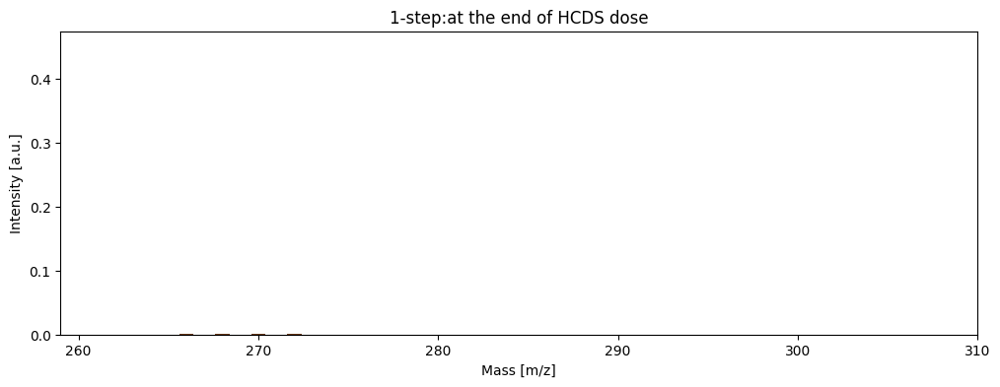

In [148]:
for i in range(6):
    plt.figure(figsize=(12,4))
    plt.bar(df1_pre_ratio.loc[604].index, df1_pre_ratio.loc[604].values, color=colors[5])
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    # plt.ylim(0,0.05)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Intensity [a.u.]')
    plt.title('1-step:at the end of HCDS dose')
    plt.show()

In [ ]:
# split df1_pre into two parts and get maximum values
df1_pre_hcds = df1_pre_ratio.loc[600:605]
df1_pre_nh3 = df1_pre_ratio.loc[606:]

for i in range(6):
    plt.figure(figsize=(12,4))
    plt.bar(df1_pre_hcds.agg('std').index, df1_pre_hcds.agg('std').values, color=colors[4])
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.1)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Standard variation')
    plt.title('Byproducts after HCDS dose')
    plt.show()

for i in range(6):
    plt.figure(figsize=(12,4))
    plt.bar(df1_pre_nh3.agg('std').index, df1_pre_nh3.agg('std').values, color=colors[6])
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.1)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Standard variation')
    plt.title('Byproducts after NH3 dose')
    plt.show()

In [180]:
# create a df for comparison
df1_std = df1_pre_hcds.agg('std').T.to_frame()
df1_std = df1_std.rename(columns={0:'Byproducts of HCDS'})
df1_std['Byproducts of NH3'] = df1_pre_nh3.agg('std').T
df1_std = df1_std.reset_index()
df1_std

,index,Byproducts of HCDS,Byproducts of NH3
0,2,0.000014,0.000061
1,3,0.000013,0.000031
2,4,0.000012,0.000022
3,5,0.000009,0.000013
4,6,0.000010,0.000020
...,...,...,...
309,311,0.000004,0.000007
310,312,0.000003,0.000004
311,313,0.000004,0.000005
312,314,0.000002,0.000012


In [ ]:
for i in range(6):
    axs = df1_std.plot(figsize=(12,3), x='index', y=['Byproducts of HCDS', 'Byproducts of NH3'], kind='bar', color=[colors[12],colors[15]])
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.2)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Standard deviation w.r.t ratio')
    # plt.title('Comparison between the Max Mass Spectra')
    plt.show()

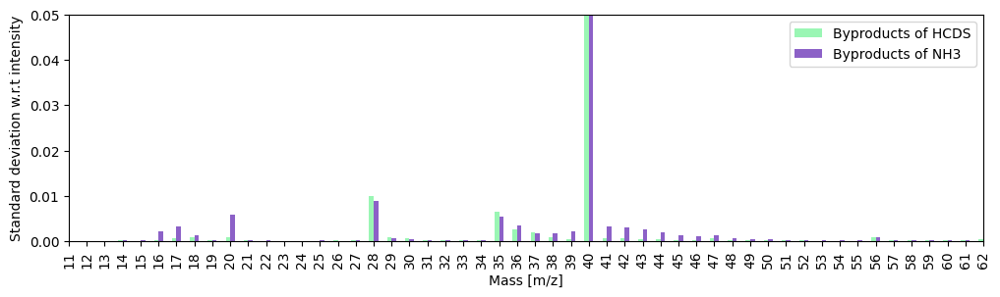

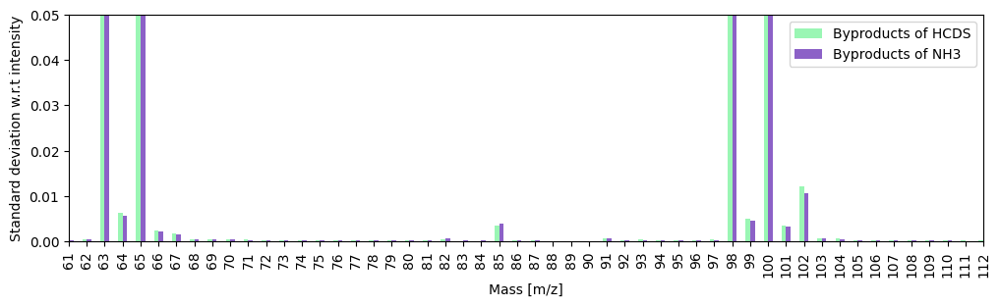

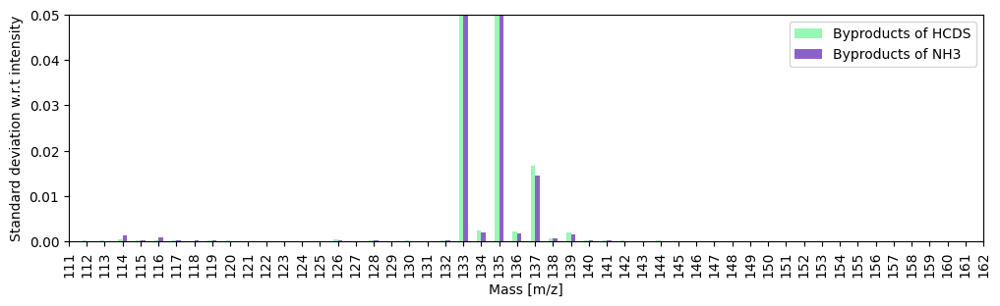

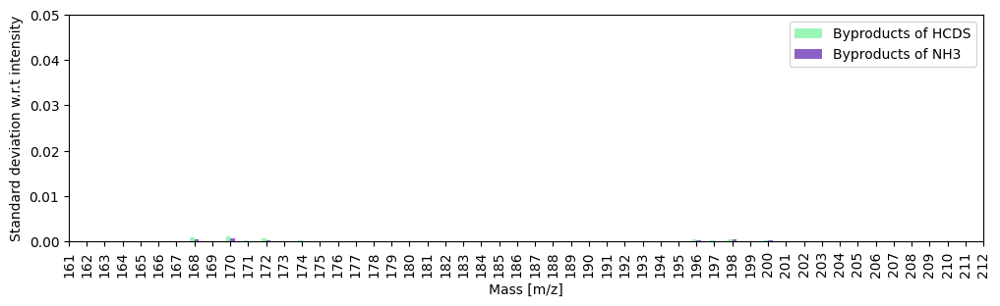

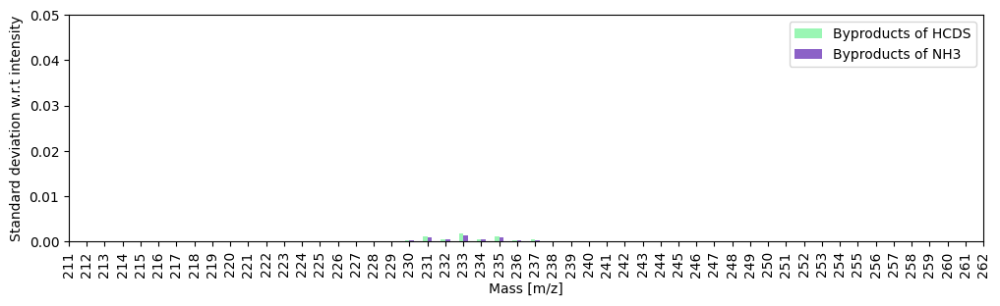

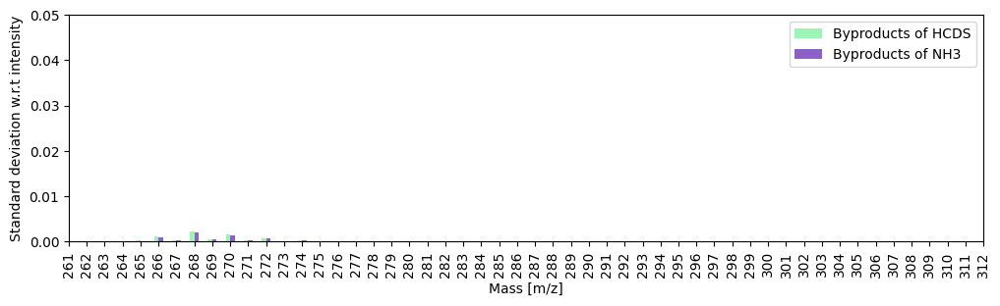

In [206]:
df1_pre_hcds = df1_pre.loc[600:605]
df1_pre_nh3 = df1_pre.loc[606:]

# create a df for comparison
df1_std = df1_pre_hcds.agg('std').T.to_frame()
df1_std = df1_std.rename(columns={0:'Byproducts of HCDS'})
df1_std['Byproducts of NH3'] = df1_pre_nh3.agg('std').T
df1_std = df1_std.reset_index()
df1_std

for i in range(6):
    axs = df1_std.plot(figsize=(12,3), x='index', y=['Byproducts of HCDS', 'Byproducts of NH3'], kind='bar', color=[colors[14],colors[18]])
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.05)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Standard deviation w.r.t intensity')
    # plt.title('Comparison between the Max Mass Spectra')
    plt.show()

In [68]:
# two interactive plots
# make them interactive
x = df2_pre_ratio.loc[:,40].index
y1 = df2_pre_ratio.loc[:,40]
y2 = df2_pre_ratio.loc[:,17]
y3 = df2_pre_ratio.loc[:,28]
clicked = []

fig = go.FigureWidget([go.Scatter(x=x, y=y1, mode='lines+markers', name='Ar(40)'), 
                       go.Scatter(x=x, y=y2, mode='lines+markers', name='NH3(17)'),
                      go.Scatter(x=x, y=y3, mode='lines+markers', name='N2(28)')])
fig.update_layout(plot_bgcolor="white", yaxis_range=[0,1], xaxis_title='Time [s]', 
                  yaxis_title='Intensity ratio', title='2-step process')
fig.update_xaxes(mirror=True, gridcolor='lightgrey', showgrid=True, linecolor='lightgray', showline=True)
fig.update_yaxes(mirror=True, gridcolor='lightgrey', showgrid=True, linecolor='lightgray', showline=True)

#1
scatter1 = fig.data[0]
cust_color1 = colors[3]
scatter1.line.color = cust_color1
scatter1.marker.color = [cust_color1] * len(x)
scatter1.marker.size = [4] * len(x)
scatter1.marker.line.color = [cust_color1] * len(x)
scatter1.marker.line.width = [1] * len(x)
#2
scatter2 = fig.data[1]
cust_color2 = colors[5]
scatter2.line.color = cust_color2
scatter2.marker.color = [cust_color2] * len(x)
scatter2.marker.size = [4] * len(x)
scatter2.marker.line.color = [cust_color2] * len(x)
scatter2.marker.line.width = [1] * len(x)
#3
scatter2 = fig.data[1]
cust_color2 = colors[7]
scatter2.line.color = cust_color2
scatter2.marker.color = [cust_color2] * len(x)
scatter2.marker.size = [4] * len(x)
scatter2.marker.line.color = [cust_color2] * len(x)
scatter2.marker.line.width = [1] * len(x)
fig.layout.hovermode = 'closest'


# create our callback functions
def update_point(trace, points, selector):
    #1
    c1 = list(scatter1.marker.color)
    s1 = list(scatter1.marker.size)
    for i in points.point_inds:
        c1[i] = colors[2]
        s1[i] = 10
        with fig.batch_update():
            scatter1.marker.color = c1
            scatter1.marker.size = s1
    #2
    c2 = list(scatter2.marker.color)
    s2 = list(scatter2.marker.size)
    for j in points.point_inds:
        c2[j] = colors[3]
        s2[j] = 10
        with fig.batch_update():
            scatter2.marker.color = c2
            scatter2.marker.size = s2
            
def store_value(trace, points, selector):
    global clicked
    clicked.append([points.__dict__['_xs'][0], points.__dict__['_ys'][0]])
    # df_peak.loc[len(df_peak)] = [points.__dict__['_xs'][0], points.__dict__['_ys'][1]]
    
def display_value(trace, points, selector):
    for point in points.point_inds:
        print(point)
        x_value = trace.x[point]
        y_value = trace.y[point]
        fig.add_annotation(x=x_value, y=y_value,
            text=f"<b>{np.round(x_value,3)}</b>", ax=0, ay=-25, font=dict(size=10))       
def wrapper(trace, points, selector):
    update_point(trace, points, selector)
    store_value(trace, points, selector)
    display_value(trace, points, selector)
    
# scatter1.on_click(wrapper)
scatter1.on_click(wrapper)
# scatter.on_click(store_value)

fig.show()

FigureWidget({
    'data': [{'line': {'color': '#C2DB1F'},
              'marker': {'color': [#C2DB1F, #C2DB1F, #C2DB1F, ..., #C2DB1F,
                                   #C2DB1F, #C2DB1F],
                         'line': {'color': [#C2DB1F, #C2DB1F, #C2DB1F, ...,
                                            #C2DB1F, #C2DB1F, #C2DB1F],
                                  'width': [1, 1, 1, ..., 1, 1, 1]},
                         'size': [4, 4, 4, ..., 4, 4, 4]},
              'mode': 'lines+markers',
              'name': 'Ar(40)',
              'type': 'scatter',
              'uid': '0731dfb3-eb53-487d-ab01-cbf4411a6d36',
              'x': {'bdata': ('ZmZmZmZmhEAAAAAAAGiEQJqZmZmZaY' ... 'AA6IZAmpmZmZnphkAzMzMzM+uGQA=='),
                    'dtype': 'f8'},
              'y': {'bdata': ('QOub28567T+wZLFsjjrtPwPL8fMNJe' ... 'AhoOw/GgRdaoOS7D9EpuFeJKXsPw=='),
                    'dtype': 'f8'}},
             {'line': {'color': '#BE90DF'},
              'marker': {'color': [#BE90DF, #BE90

In [ ]:
plt.figure(figsize=(12,3))
plt.plot(df2_pre_ratio.loc[:,40],'.-', color=colors[4])
plt.plot(df2_pre_ratio.loc[:,17],'.-', color=colors[6])
plt.plot(df2_pre_ratio.loc[:,28],'.-', color=colors[9])
plt.xlabel('Time [s]')
# plt.xlim(640,1100)
plt.ylabel('Intensity ratio')
plt.legend(['Ar (40)','N2 (28)','NH3 (17)'], bbox_to_anchor=(1,1.02), loc='upper left')
plt.title('2-step process')
plt.show()

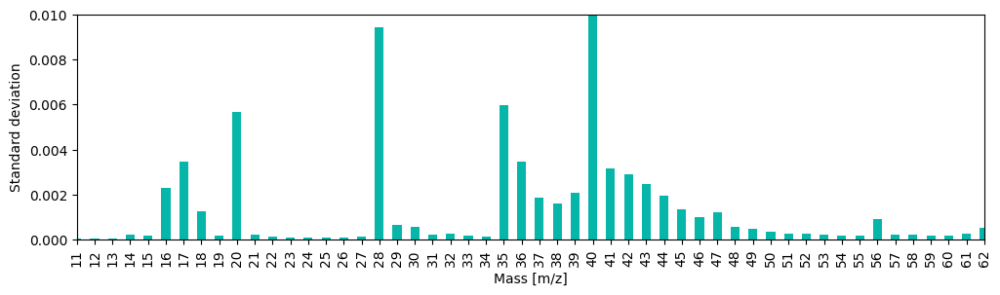

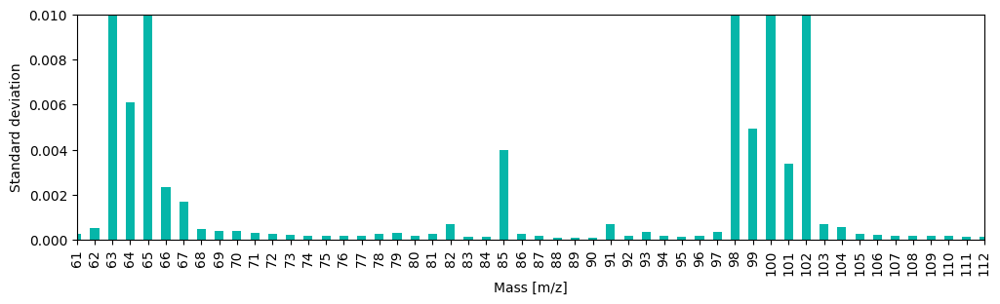

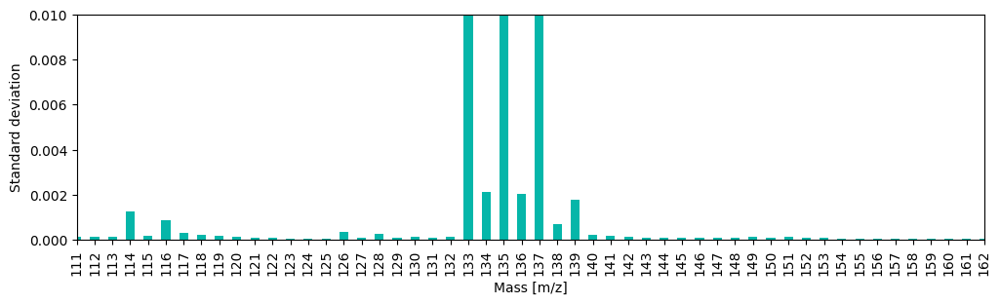

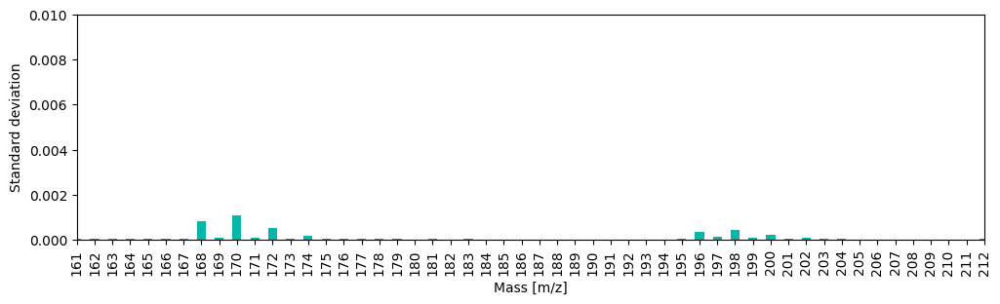

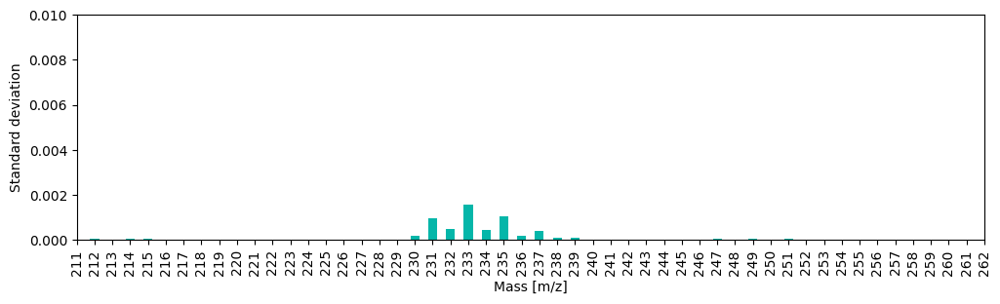

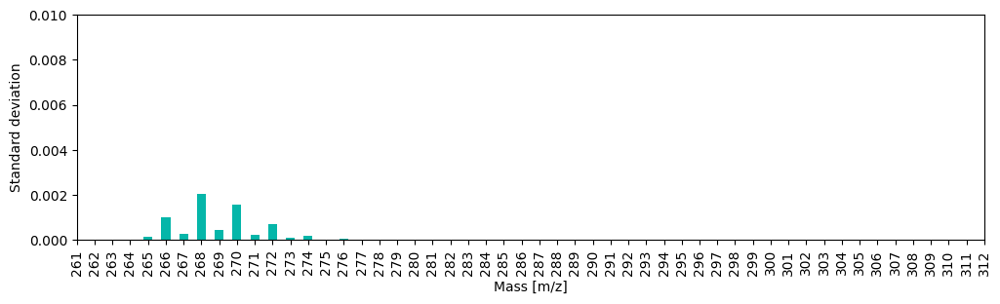

In [90]:
for i in range(6):
    axs = df1_pre.agg(['std']).T.reset_index().plot(figsize=(12,3), x='index', y='std', kind='bar', color=colors[10], legend=False)
    plt.xlim([10+50*i-1, 10+50*(i+1)])
    plt.ylim(0,0.01)
    plt.xlabel('Mass [m/z]')
    plt.ylabel('Standard deviation')
    # plt.title('Comparison between the Max Mass Spectra')
    plt.show()

# fig = axs.get_figure()
# fig.savefig(f'data/figure/1step_prepost{i}', bbox_inches='tight')